In [1]:
# mount to my google drive to access East model
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [2]:
%cd /content/drive/My\ Drive/Project/heali
%ls
!pip install opencv-contrib-python
!pip install --upgrade imutils

/content/drive/My Drive/Project/heali
db2Bash.sh  frozen_east_text_detection.pb
Requirement already up-to-date: imutils in /usr/local/lib/python3.6/dist-packages (0.5.3)


In [0]:


# import the necessary packages
from skimage import io
import numpy as np
import argparse
import time
import cv2
import json
import requests
from imutils.object_detection import non_max_suppression
from google.colab.patches import cv2_imshow
menuList= ["surf-n-fries","chipotle","the_bittmore","deepblue", 
           "the_tipsy_boar","kosher_menu","shabu_shabu","gus_new-york_pizza",
           "healthy_food_menu","cow_boy_menu"]
baseDomain = 'https://e8xmodukxg.execute-api.us-east-1.amazonaws.com/dev/users/'
awsUrl = 'https://heali-interview-screening.s3.amazonaws.com/'
urlList = [baseDomain+manu for manu in menuList]

[INFO] loading EAST text detector...
[INFO] text detection took 2.270823 seconds


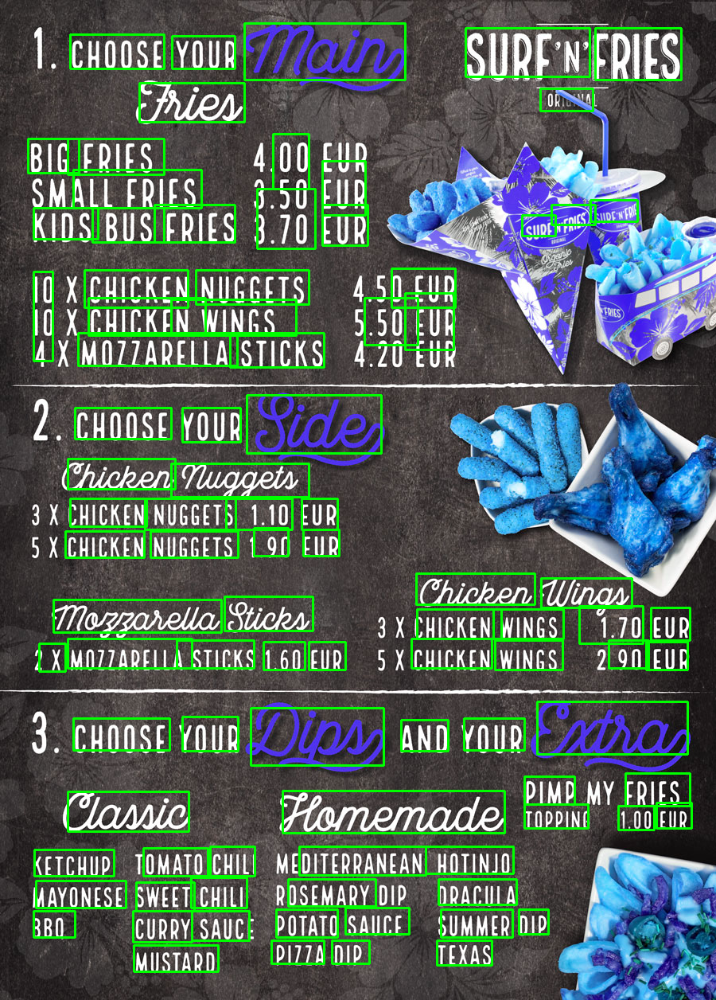

[INFO] loading EAST text detector...
[INFO] text detection took 2.239802 seconds


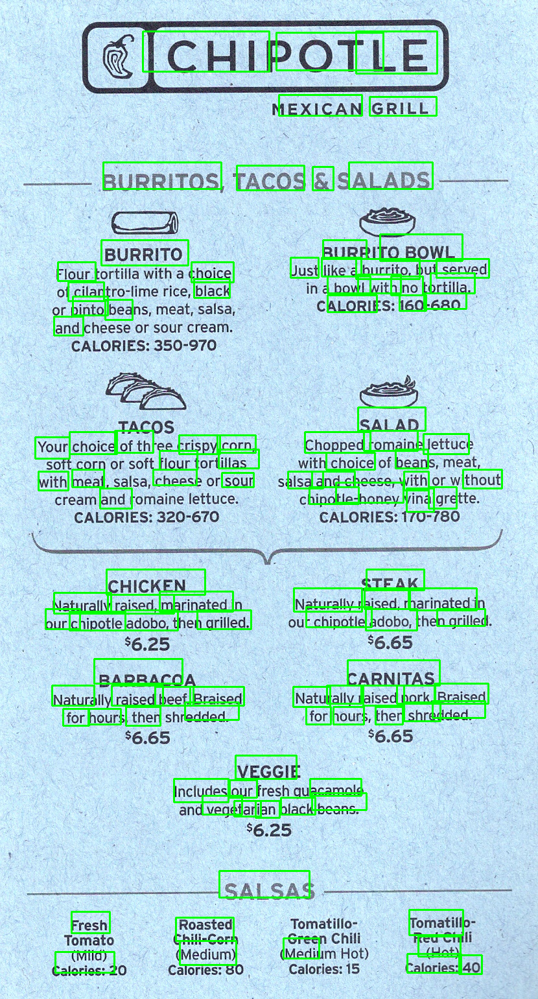

[INFO] loading EAST text detector...
[INFO] text detection took 2.228393 seconds


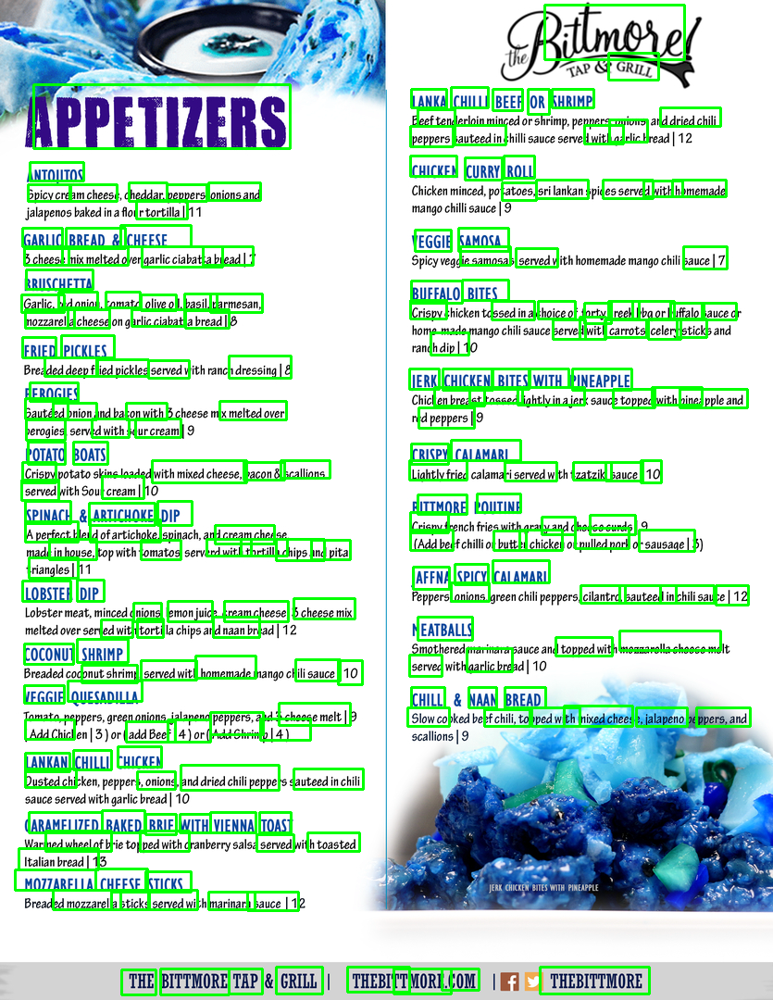

[INFO] loading EAST text detector...
[INFO] text detection took 2.227581 seconds


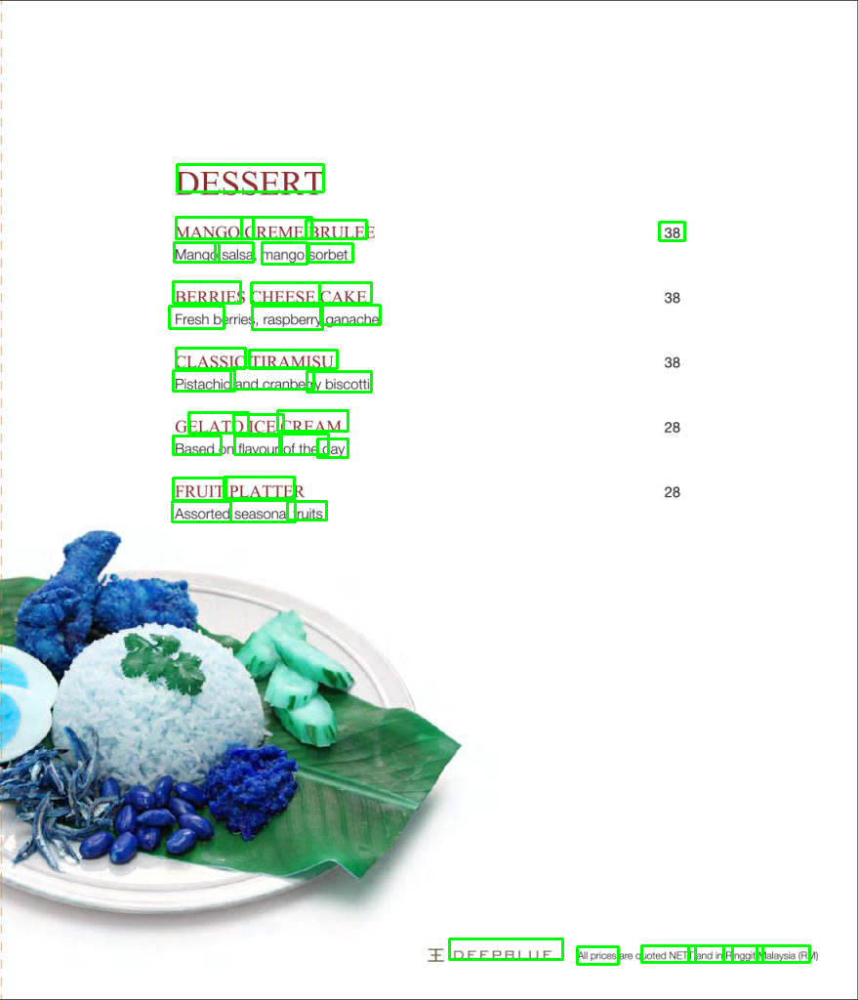

[INFO] loading EAST text detector...
[INFO] text detection took 2.266788 seconds


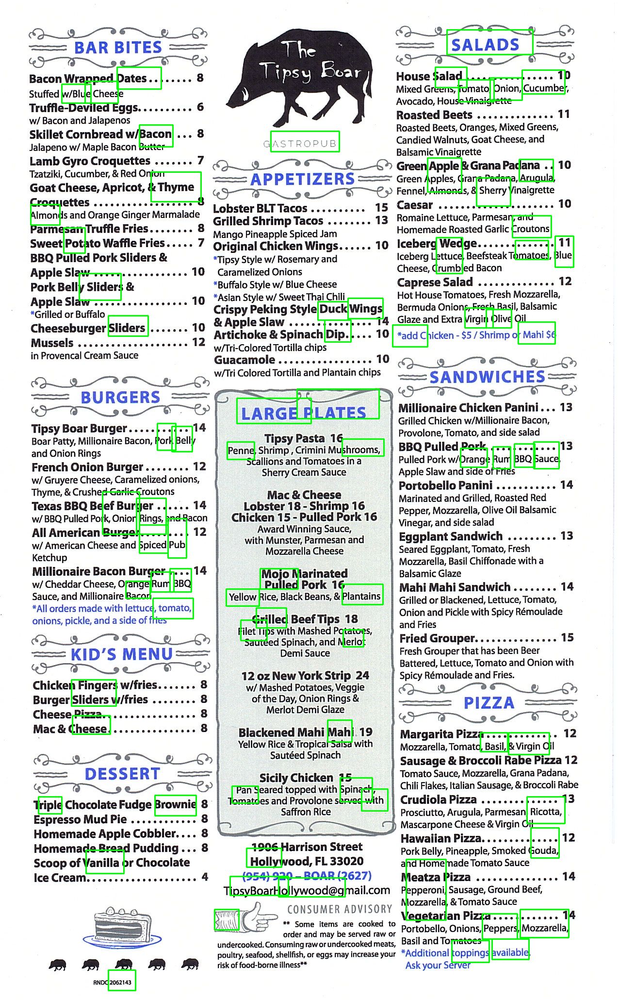

[INFO] loading EAST text detector...
[INFO] text detection took 2.255833 seconds


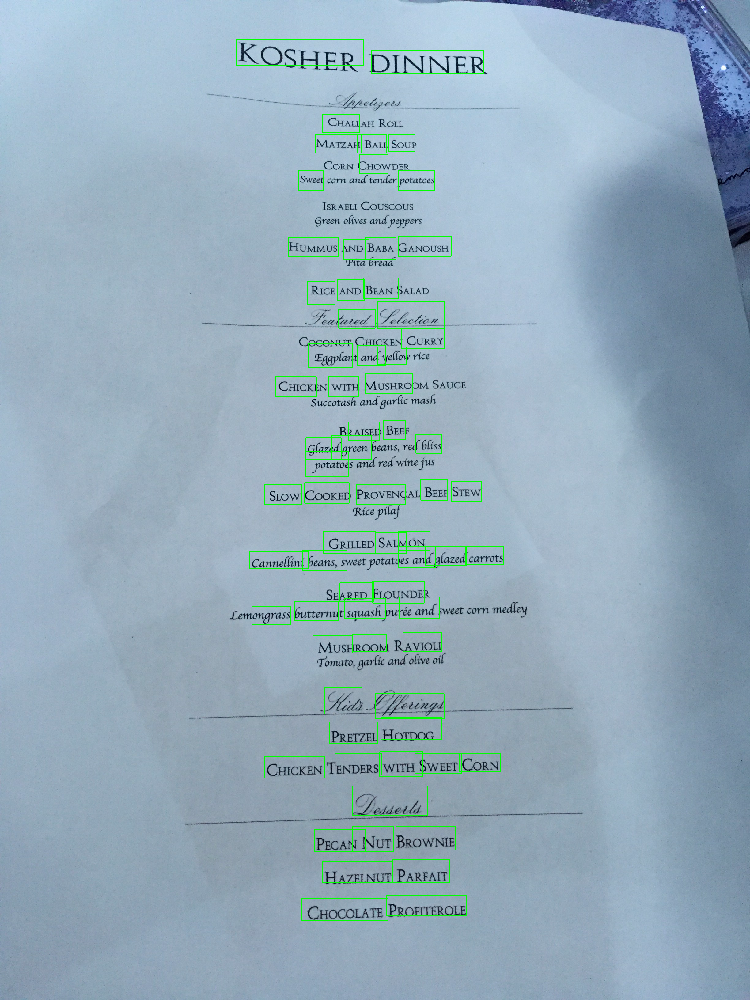

[INFO] loading EAST text detector...
[INFO] text detection took 2.234569 seconds


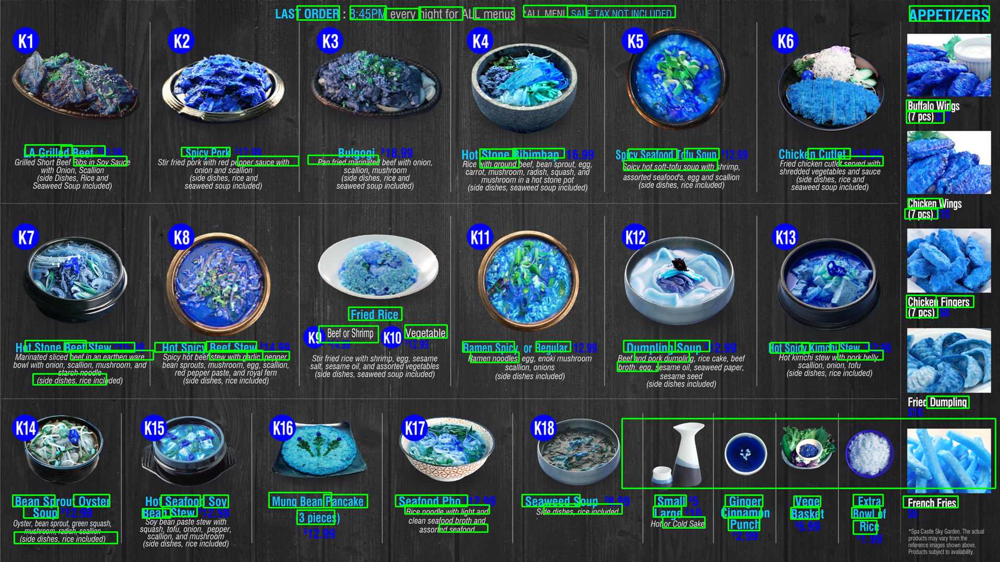

[INFO] loading EAST text detector...
[INFO] text detection took 2.391648 seconds


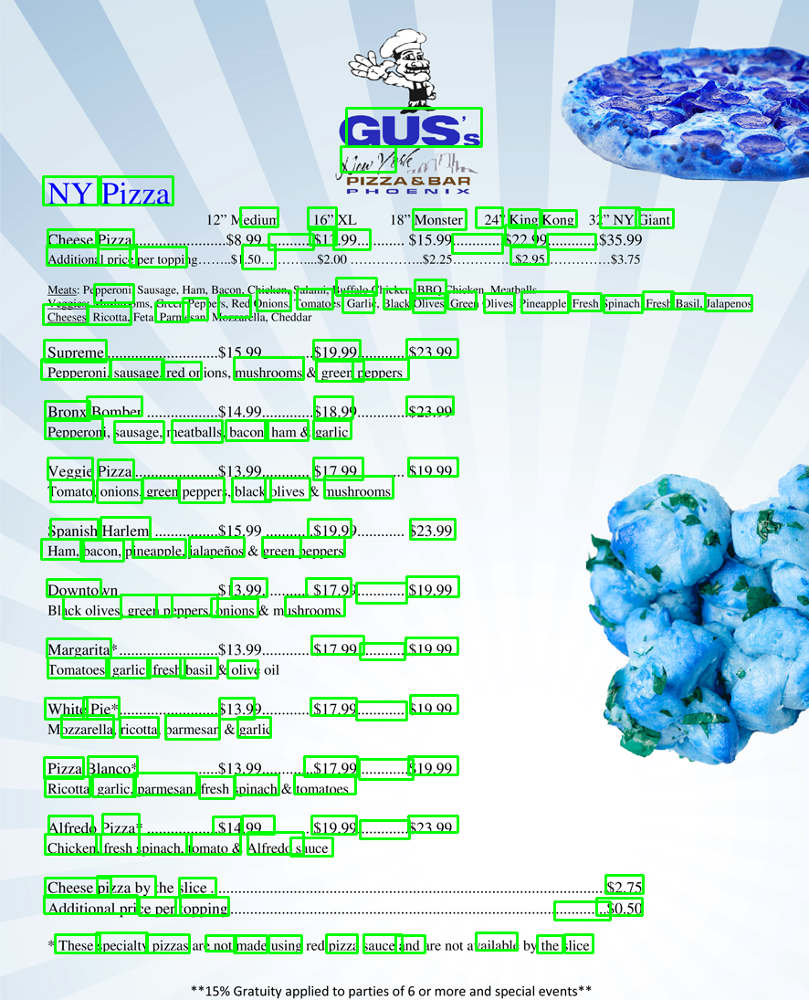

[INFO] loading EAST text detector...
[INFO] text detection took 2.295085 seconds


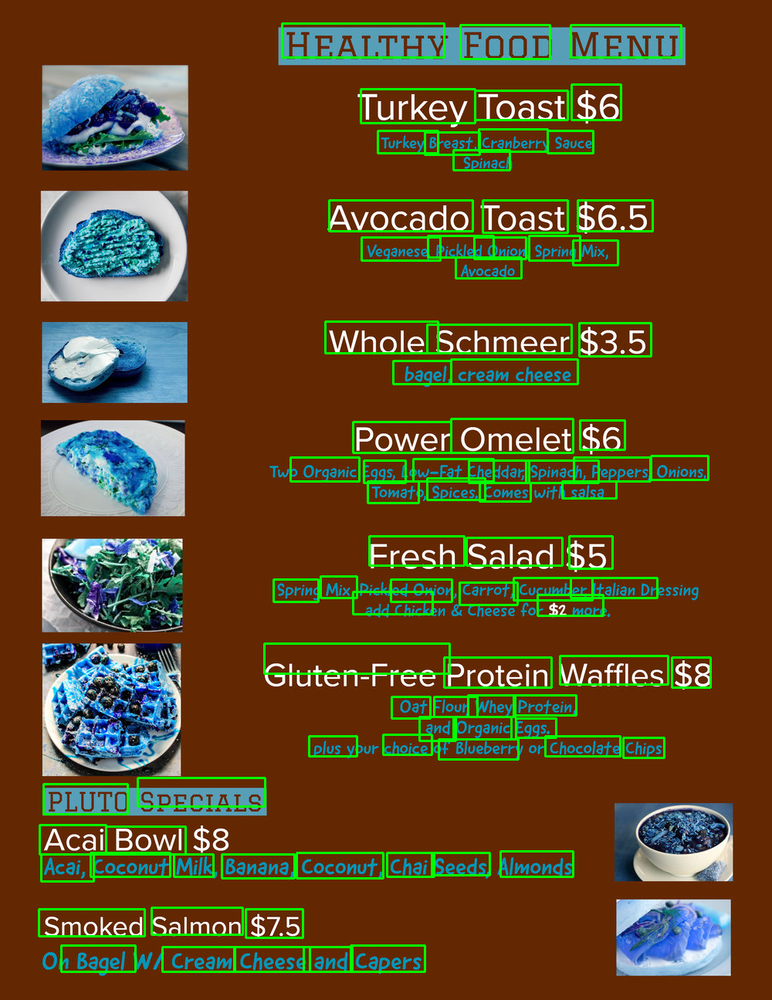

[INFO] loading EAST text detector...
[INFO] text detection took 2.267568 seconds


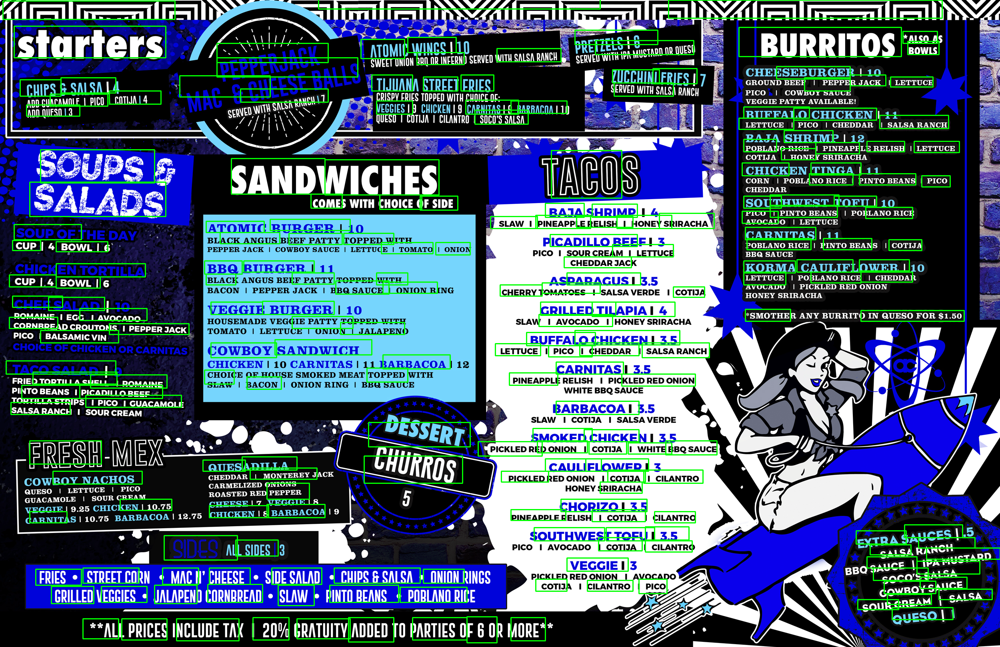

In [6]:


boundingBoxDict = dict()

for i in range(len(urlList)):
  respones = requests.get(urlList[i]).json()
  imagePath = (respones['menuPath'])
  imageUrl = awsUrl + imagePath
  # image = cv2.imread(imageUrl)
  image = io.imread(imageUrl)

  args = {"image":imageUrl, "width":640,"height":640,"east":'frozen_east_text_detection.pb',
          "min_confidence":0.3}
  # load the input image and grab the image dimensions
  image = io.imread(args["image"])
  # image = cv2.imread()
  orig = image.copy()
  (H, W) = image.shape[:2]

  # set the new width and height and then determine the ratio in change
  # for both the width and height
  (newW, newH) = (args["width"], args["height"])
  rW = W / float(newW)
  rH = H / float(newH)

  # resize the image and grab the new image dimensions
  image = cv2.resize(image, (newW, newH))
  (H, W) = image.shape[:2]

  # define the two output layer names for the EAST detector model that
  # we are interested -- the first is the output probabilities and the
  # second can be used to derive the bounding box coordinates of text
  layerNames = [
      "feature_fusion/Conv_7/Sigmoid",
      "feature_fusion/concat_3"]

  # load the pre-trained EAST text detector
  print("[INFO] loading EAST text detector...")
  net = cv2.dnn.readNet(args["east"])

  # construct a blob from the image and then perform a forward pass of
  # the model to obtain the two output layer sets
  blob = cv2.dnn.blobFromImage(image, 1.0, (W, H),
                              (123.68, 116.78, 103.94), swapRB=True, crop=False)
  start = time.time()
  net.setInput(blob)
  (scores, geometry) = net.forward(layerNames)
  end = time.time()

  # show timing information on text prediction
  print("[INFO] text detection took {:.6f} seconds".format(end - start))

  # grab the number of rows and columns from the scores volume, then
  # initialize our set of bounding box rectangles and corresponding
  # confidence scores
  (numRows, numCols) = scores.shape[2:4]
  rects = []
  confidences = []

  # loop over the number of rows
  for y in range(0, numRows):
      # extract the scores (probabilities), followed by the geometrical
      # data used to derive potential bounding box coordinates that
      # surround text
      scoresData = scores[0, 0, y]
      xData0 = geometry[0, 0, y]
      xData1 = geometry[0, 1, y]
      xData2 = geometry[0, 2, y]
      xData3 = geometry[0, 3, y]
      anglesData = geometry[0, 4, y]

      # loop over the number of columns
      for x in range(0, numCols):
          # if our score does not have sufficient probability, ignore it
          if scoresData[x] < args["min_confidence"]:
              continue

          # compute the offset factor as our resulting feature maps will
          # be 4x smaller than the input image
          (offsetX, offsetY) = (x * 4.0, y * 4.0)

          # extract the rotation angle for the prediction and then
          # compute the sin and cosine
          angle = anglesData[x]
          cos = np.cos(angle)
          sin = np.sin(angle)

          # use the geometry volume to derive the width and height of
          # the bounding box
          h = xData0[x] + xData2[x]
          w = xData1[x] + xData3[x]

          # compute both the starting and ending (x, y)-coordinates for
          # the text prediction bounding box
          endX = int(offsetX + (cos * xData1[x]) + (sin * xData2[x]))
          endY = int(offsetY - (sin * xData1[x]) + (cos * xData2[x]))
          startX = int(endX - w)
          startY = int(endY - h)

          # add the bounding box coordinates and probability score to
          # our respective lists
          rects.append((startX, startY, endX, endY))
          confidences.append(scoresData[x])

  # apply non-maxima suppression to suppress weak, overlapping bounding
  # boxes
  boxes = non_max_suppression(np.array(rects), probs=confidences)
  rects = []
  # loop over the bounding boxes
  for (startX, startY, endX, endY) in boxes:
      # scale the bounding box coordinates based on the respective
      # ratios
      startX = int(startX * rW)
      startY = int(startY * rH)
      endX = int(endX * rW)
      endY = int(endY * rH)
      rects.append([startX, startY,endX, endY])
      # draw the bounding box on the image
      cv2.rectangle(orig, (startX, startY), (endX, endY), (0, 255, 0), 2)

  boundingBoxDict[menuList[i]] = {"menuId":menuList[i], "jsonStr":rects}
  # show the output image
  cv2_imshow( orig)
  cv2.waitKey(0)

In [7]:
# generate command
commandprx = 'curl -H "Content-Type: application/json" -X POST ${BASE_DOMAIN}/table -d '
for manu in boundingBoxDict.keys():
  c1 = (commandprx + "\'" +json.dumps(boundingBoxDict[manu]) + "\'")
  print(c1)


curl -H "Content-Type: application/json" -X POST ${BASE_DOMAIN}/table -d '{"menuId": "surf-n-fries", "jsonStr": [[680, 726, 794, 763], [659, 1010, 739, 1040], [282, 749, 393, 792], [168, 1187, 274, 1220], [551, 1104, 649, 1136], [85, 994, 237, 1044], [67, 753, 278, 794], [362, 1104, 472, 1138], [523, 720, 672, 759], [88, 626, 184, 661], [229, 512, 302, 555], [554, 1142, 644, 1177], [693, 257, 748, 282], [216, 45, 295, 86], [585, 35, 741, 96], [748, 35, 856, 100], [88, 43, 206, 86], [347, 1142, 424, 1177], [222, 804, 319, 839], [434, 1140, 514, 1173], [355, 993, 634, 1046], [45, 1106, 158, 1140], [675, 881, 864, 947], [92, 213, 253, 261], [310, 496, 479, 569], [229, 900, 299, 943], [652, 1142, 689, 1173], [175, 104, 307, 153], [504, 904, 563, 943], [92, 902, 213, 942], [94, 512, 215, 551], [315, 889, 482, 961], [307, 29, 509, 100], [583, 902, 659, 942], [289, 418, 407, 461], [241, 1144, 313, 1181], [825, 1008, 869, 1040], [656, 270, 698, 296], [35, 174, 99, 217], [85, 174, 206, 219], [1

(2.8125, 3.925)